## Comparisons

This code can execute the following variants of losses:  

1. **Variant 1:**  Purely Physics  
   $L_{\theta} = L_{\text{PDE}}$  
   Use $n_{\text{used}} = 0$  

2. **Variant 2:**  Physics + Data  
   $L_{\theta} = L_{\text{PDE}} + \Sigma_{i=1}^{n_{\text{used}}}\| u_i - \hat{u}_i \|_2^2$  
   Use $n_{\text{used}} \in (0, 300]$  

All the results presented were obtained as follows:
1. By estimating the gradients in the physics-informed loss terms using forward mode automatic differentiation (AD).
2. The output field values at given grid points were computed in one forward pass of the network using the einsum function.

In [1]:
import numpy as np
import torch
from torch import nn
import torch.nn.functional as F
from torchsummary import summary
import torch.distributions as td
import math
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import argparse
import random
import os
import time 
import pickle
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from termcolor import colored
from sklearn import metrics

import sys
sys.path.append("../..")

from utils.networks import *
from utils.visualizer_misc import *
from utils.forward_autodiff import *
from utils.misc import *

from utils.deeponet_networks_2d import *
from utils.visualizer_2d import *

import warnings
warnings.filterwarnings("ignore")

In [2]:
# Tag this cell with 'parameters'
# parameters
seed = 0 # Seed number.
n_used = 150 # Number of full training fields used for estimating the data-driven loss term
n_iterations = 80000 # Number of iterations.
use_fourier_features = True
n_fourier = 10 # Number of fourier frequencies considered.
save = True # Save results.

In [3]:
# Parameters
seed = 0
n_used = 0
save = True


In [4]:
if save == True:
    resultdir = os.path.join(os.getcwd(),'results','b_Latent-NO','seed='+str(seed)+'_n_used='+str(n_used)) 
    if not os.path.exists(resultdir):
        os.makedirs(resultdir)
else:
    resultdir = None

In [5]:
set_seed(seed)

seed = 0


In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [7]:
# Load the data
data = torch.load(os.path.join('..','..','data/2D_Burgers_equation_scalar/Burgers_equation_2D_scalar.pt'))

for key, tensor in data.items():
    print(f"{key}: {tensor.shape}")
    
# Random Initial conditions: Nsamples x 32 x 32, each IC sample is (32 x 32)
# Time evolution of the solution field: Nsamples x 21 x 32 x 32.
# Each field is  21 x 32 x 32, rows correspond to time and other dimensions correspond to the field.
# First row corresponds to solution at t=0 (1st time step)
# and next  row corresponds to solution at t=0.05 (2nd time step) and so on.
# last row correspond to solution at t=1 (21st time step).

input_samples: torch.Size([350, 32, 32])
output_samples: torch.Size([350, 21, 32, 32])
t_span: torch.Size([21])
x_span: torch.Size([32, 32])
y_span: torch.Size([32, 32])


In [8]:
inputs = data['input_samples'].float().to(device)
outputs = data['output_samples'].float().to(device)
t_span = data['t_span'].float().to(device)
x_span = data['x_span'].float().to(device)
y_span = data['y_span'].float().to(device)

L = 1.         # Simulation domain [0, L]^2
T = 1.         # Simulation time [0, T]

nt, nx, ny = len(t_span), len(x_span), len(y_span) # number of discretizations in time, location_x and location_y.

grid = torch.vstack((t_span.repeat_interleave(ny*nx), 
              x_span.flatten().repeat(nt),
              y_span.flatten().repeat(nt))).T
print("Shape of grid:", grid.shape) # (nt*nx*ny, 3)
print("grid:", grid) # time, location_x, location_y

# Split the data into training and testing samples
inputs_train, inputs_test, outputs_train, outputs_test = train_test_split(inputs, outputs, test_size=50, random_state=seed)

# Check the shapes of the subsets
print("Shape of inputs_train:", inputs_train.shape)
print("Shape of inputs_test:", inputs_test.shape)
print("Shape of outputs_train:", outputs_train.shape)
print("Shape of outputs_test:", outputs_test.shape)
print('#'*100)

Shape of grid: torch.Size([21504, 3])
grid: tensor([[0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0323],
        [0.0000, 0.0000, 0.0645],
        ...,
        [1.0000, 1.0000, 0.9355],
        [1.0000, 1.0000, 0.9677],
        [1.0000, 1.0000, 1.0000]], device='cuda:0')
Shape of inputs_train: torch.Size([300, 32, 32])
Shape of inputs_test: torch.Size([50, 32, 32])
Shape of outputs_train: torch.Size([300, 21, 32, 32])
Shape of outputs_test: torch.Size([50, 21, 32, 32])
####################################################################################################


In [9]:
# Of these full training fields available I am using only n_used fields for estimating the data-driven loss term 
inputs_train_used = inputs_train[:n_used, :, :]
print("Shape of inputs_train_used:", inputs_train_used.shape)
outputs_train_used = outputs_train[:n_used, :, :, :]
print("Shape of outputs_train_used:", outputs_train_used.shape)

Shape of inputs_train_used: torch.Size([0, 32, 32])
Shape of outputs_train_used: torch.Size([0, 21, 32, 32])


In [10]:
inputs_initial_fields_only = torch.load(os.path.join('..','..','data/2D_Burgers_equation_scalar/Burgers_equation_2D_scalar_initial_fields_only.pt')).to(device)
print(inputs_initial_fields_only.shape)

torch.Size([1000, 32, 32])


In [11]:
def fourier_features_temporal(t, n_fourier):
    pi = math.pi
    result = torch.zeros(t.size(0), 1+(2*n_fourier)).to(device)  # Initialize result tensor

    t = t.squeeze()

    # Compute the transformation
    result[:, 0] = t
    for i in range(n_fourier):
        result[:, 2*i + 0 + 1] = torch.cos((i + 1) * pi * t)
        result[:, 2*i + 1 + 1] = torch.sin((i + 1) * pi * t)
    return result

In [12]:
def fourier_features_spatial(x, y, n_fourier):
    pi = math.pi
    result = torch.zeros(x.size(0), 2+(4*n_fourier)).to(device)  # Initialize result tensor
    
    x = x.squeeze()
    y = y.squeeze()
    
    # Compute the transformation
    result[:, 0] = x
    result[:, 1] = y
    for i in range(n_fourier):
        result[:, 4*i + 0 + 2] = torch.cos((i + 1) * pi * x)
        result[:, 4*i + 1 + 2] = torch.sin((i + 1) * pi * x)
        result[:, 4*i + 2 + 2] = torch.cos((i + 1) * pi * y)
        result[:, 4*i + 3 + 2] = torch.sin((i + 1) * pi * y)
    return result

In [13]:
latent_dim = 60 # d_z

In [14]:
"""
input_neurons_latent_branch: Number of input neurons in the latent_branch net.
input_neurons_latent_trunk: Number of input neurons in the latent_trunk net.
latent_p: Number of output neurons in both the latent_branch and latent_trunk net.
"""
latent_p = latent_dim*10 # Number of output neurons in both the latent_branch and latent_trunk net.

input_neurons_latent_branch = (ny, nx) # Specify input size of image as a tuple (height, width)
n_channels = 1
num_filters = [20, 30, 40]
filter_sizes = [3, 3, 3]
strides = [1]*len(num_filters)
paddings = [0]*len(num_filters)
poolings = [('avg', 2, 2), ('avg', 2, 2), ('avg', 2, 2)]  # Pooling layer specification (type, kernel_size, stride)
end_MLP_layersizes = [150, 150, latent_p]
activation = nn.SiLU() # nn.ReLU() #Sin() #nn.LeakyReLU() #nn.Tanh()
latent_branch_net = ConvNet(input_neurons_latent_branch, n_channels, num_filters, filter_sizes, strides, paddings, poolings, end_MLP_layersizes, activation)
latent_branch_net.to(device)
# print(latent_branch_net)
print('LATENT BRANCH-NET SUMMARY:')
summary(latent_branch_net, input_size=(n_channels, ny, nx))  # input shape is (channels, height, width)
print('#'*100)

# 1 corresponds to t
input_neurons_latent_trunk = 1 # Number of input neurons in the trunk net.
latent_trunk_net = DenseNet(layersizes=[input_neurons_latent_trunk] + [128]*4 + [latent_p], activation=nn.SiLU()) #Sin() #nn.LeakyReLU() #nn.Tanh()
latent_trunk_net.to(device)
# print(latent_trunk_net)
print('LATENT TRUNK-NET SUMMARY:')
summary(latent_trunk_net, input_size=(input_neurons_latent_trunk,))
print('#'*100)

"""
input_neurons_reconstruction_branch: Number of input neurons in the reconstruction_branch net.
input_neurons_reconstruction_trunk: Number of input neurons in the reconstruction_trunk net.
reconstruction_q: Number of output neurons in both the reconstruction_branch and reconstruction_trunk net.
"""
reconstruction_q = 128 # Number of output neurons in both the reconstruction_branch and reconstruction_trunk net.

input_neurons_reconstruction_branch = latent_dim # d_z
reconstruction_branch_net = DenseNet(layersizes=[input_neurons_reconstruction_branch] + [128]*4 + [reconstruction_q], activation=nn.SiLU()) #Sin() #nn.LeakyReLU() #nn.Tanh()
reconstruction_branch_net.to(device)
# print(reconstruction_branch_net)
print('RECONSTRUCTION BRANCH-NET SUMMARY:')
summary(reconstruction_branch_net, input_size=(input_neurons_reconstruction_branch,))  
print('#'*100)

# 2 corresponds to x and y
if use_fourier_features == False:
    input_neurons_reconstruction_trunk = 2 # Number of input neurons in the trunk net.
else:
    input_neurons_reconstruction_trunk = 2 + (4*n_fourier) # Number of input neurons in the trunk net.
reconstruction_trunk_net = DenseNet(layersizes=[input_neurons_reconstruction_trunk] + [128]*4 + [reconstruction_q], activation=nn.SiLU()) #Sin() #nn.LeakyReLU() #nn.Tanh()
reconstruction_trunk_net.to(device)
# print(reconstruction_trunk_net)
print('RECONSTRUCTION TRUNK-NET SUMMARY:')
summary(reconstruction_trunk_net, input_size=(input_neurons_reconstruction_trunk,))
print('#'*100)

model = Latent_NO_model(latent_branch_net, latent_trunk_net, latent_dim, reconstruction_branch_net, reconstruction_trunk_net)
model.to(device);

LATENT BRANCH-NET SUMMARY:
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 20, 30, 30]             200
              SiLU-2           [-1, 20, 30, 30]               0
         AvgPool2d-3           [-1, 20, 15, 15]               0
            Conv2d-4           [-1, 30, 13, 13]           5,430
              SiLU-5           [-1, 30, 13, 13]               0
         AvgPool2d-6             [-1, 30, 6, 6]               0
            Conv2d-7             [-1, 40, 4, 4]          10,840
              SiLU-8             [-1, 40, 4, 4]               0
         AvgPool2d-9             [-1, 40, 2, 2]               0
          Flatten-10                  [-1, 160]               0
           Linear-11                  [-1, 150]          24,150
             SiLU-12                  [-1, 150]               0
           Linear-13                  [-1, 150]          22,650
            

In [15]:
num_learnable_parameters = (count_learnable_parameters(latent_branch_net)
                            + count_learnable_parameters(latent_trunk_net)
                            + count_learnable_parameters(reconstruction_branch_net)
                            + count_learnable_parameters(reconstruction_trunk_net))
print("Total number of learnable parameters:", num_learnable_parameters)

Total number of learnable parameters: 426470


In [16]:
def u_pred(net, inputs, t, x, y):
    if use_fourier_features == False:
        latent_prediction, reconstruction_prediction = net(inputs, t, torch.hstack([x, y])) 
    elif use_fourier_features == True:
        latent_prediction, reconstruction_prediction = net(inputs, t, fourier_features_spatial(x, y, n_fourier)) 
    u = reconstruction_prediction # (bs, neval_t, neval_loc)
    return latent_prediction, u

In [17]:
def loss_pde_residual(net, initial_fields, t, x, y):
    
    u = u_pred(net, initial_fields, t, x, y)[1]
    
    # Using forward automatic differention to estimate derivatives in the physics informed loss
    tangent_t, tangent_x, tangent_y = torch.ones(t.shape).to(device), torch.ones(x.shape).to(device), torch.ones(y.shape).to(device)
    ut = FWDAD_first_order_derivative(lambda t: u_pred(net, initial_fields, t, x, y)[1], t, tangent_t) # (bs, neval_t, neval_loc)
    ux = FWDAD_first_order_derivative(lambda x: u_pred(net, initial_fields, t, x, y)[1], x, tangent_x) # (bs, neval_t, neval_loc)
    uxx = FWDAD_second_order_derivative(lambda x: u_pred(net, initial_fields, t, x, y)[1], x, tangent_x) # (bs, neval_t, neval_loc)
    uy = FWDAD_first_order_derivative(lambda y: u_pred(net, initial_fields, t, x, y)[1], y, tangent_y) # (bs, neval_t, neval_loc)
    uyy = FWDAD_second_order_derivative(lambda y: u_pred(net, initial_fields, t, x, y)[1], y, tangent_y) # (bs, neval_t, neval_loc)
   
    pde_residual = (ut + (u*ux) + (u*uy) - (0.01*uxx) - (0.01*uyy))**2
    
    return torch.mean(pde_residual)

In [18]:
def loss_pde_bcs(net, initial_fields, t, x, y):
    
    t_left, x_left, y_left = t[0], x[0], y[0]
    t_right, x_right, y_right = t[1], x[1], y[1]
    t_bottom, x_bottom, y_bottom = t[2], x[2], y[2]
    t_top, x_top, y_top = t[3], x[3], y[3]

    u_left = u_pred(net, initial_fields, t_left, x_left, y_left)[1] # u is (bs, neval_t, neval_loc)
    u_right = u_pred(net, initial_fields, t_right, x_right, y_right)[1] # u is (bs, neval_t, neval_loc)
    u_bottom = u_pred(net, initial_fields, t_bottom, x_bottom, y_bottom)[1]  # u is (bs, neval_t, neval_loc)
    u_top = u_pred(net, initial_fields, t_top, x_top, y_top)[1] # u is (bs, neval_t, neval_loc)
    
    # bc1a and bc1b
    pde_bc1a = (u_left - u_right)**2
    tangent_x_left, tangent_x_right = torch.ones(x_left.shape).to(device), torch.ones(x_right.shape).to(device)
    ux_left = FWDAD_first_order_derivative(lambda x_left: u_pred(net, initial_fields, t_left, x_left, y_left)[1], x_left, tangent_x_left) # (bs, neval_t, neval_loc)
    ux_right = FWDAD_first_order_derivative(lambda x_right: u_pred(net, initial_fields, t_right, x_right, y_right)[1], x_right, tangent_x_right) # (bs, neval_t, neval_loc)
    pde_bc1b = (ux_left - ux_right)**2
    
    # bc2a and bc2b
    pde_bc2a = (u_bottom - u_top)**2
    tangent_y_bottom, tangent_y_top = torch.ones(y_bottom.shape).to(device), torch.ones(y_top.shape).to(device)
    uy_bottom = FWDAD_first_order_derivative(lambda y_bottom: u_pred(net, initial_fields, t_bottom, x_bottom, y_bottom)[1], y_bottom, tangent_y_bottom) # (bs, neval_t, neval_loc)
    uy_top = FWDAD_first_order_derivative(lambda y_top: u_pred(net, initial_fields, t_top, x_top, y_top)[1], y_top, tangent_y_top) # (bs, neval_t, neval_loc)
    pde_bc2b = (uy_bottom - uy_top)**2
    
    return torch.mean(pde_bc1a) + torch.mean(pde_bc1b) + torch.mean(pde_bc2a) + torch.mean(pde_bc2b)

In [19]:
def loss_pde_ic(net, initial_fields, t, x, y):
    
    u_ic = u_pred(net, initial_fields, t, x, y)[1] # u is (bs, 1, neval_loc)
    
    bs_ = initial_fields.shape[0]
    ic_values_ = torch.zeros((bs_, x.shape[0], 1)).to(device)
    for j in range(bs_):
        ic_values_[j] = linear_interpolation_2D(x, y, x_span, y_span, initial_fields[j]) # initial condition: u_0(x) values
    ic_values = ic_values_.reshape(-1, 1, x.shape[0]) # (bs, 1, neval_loc)
    
    pde_ic = (u_ic - ic_values)**2
    
    return torch.mean(pde_ic)

Iteration 0 - loss = 0.002521, data-driven loss = 0.000000, pinn loss = 0.002521, learning rate = 0.001000, test loss = 0.000923
Iteration 500 - loss = 0.001592, data-driven loss = 0.000000, pinn loss = 0.001592, learning rate = 0.001000, test loss = 0.000818
Iteration 1000 - loss = 0.001795, data-driven loss = 0.000000, pinn loss = 0.001795, learning rate = 0.001000, test loss = 0.000818
Iteration 1500 - loss = 0.001781, data-driven loss = 0.000000, pinn loss = 0.001781, learning rate = 0.001000, test loss = 0.000817
Iteration 2000 - loss = 0.001759, data-driven loss = 0.000000, pinn loss = 0.001759, learning rate = 0.001000, test loss = 0.000817
Iteration 2500 - loss = 0.001656, data-driven loss = 0.000000, pinn loss = 0.001656, learning rate = 0.001000, test loss = 0.000817
Iteration 3000 - loss = 0.001665, data-driven loss = 0.000000, pinn loss = 0.001665, learning rate = 0.001000, test loss = 0.000817
Iteration 3500 - loss = 0.001730, data-driven loss = 0.000000, pinn loss = 0.001

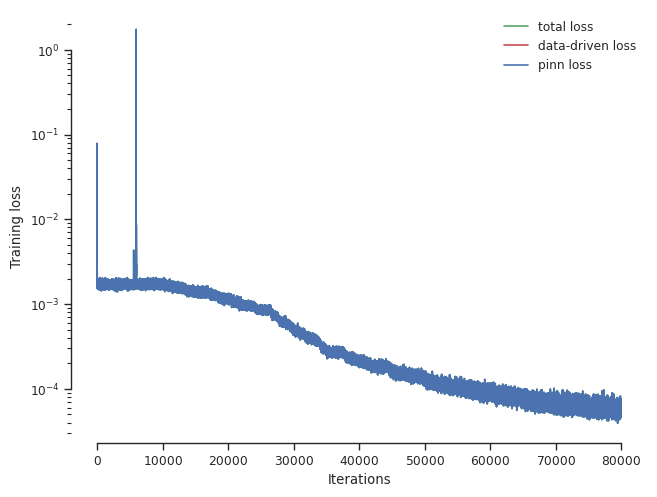

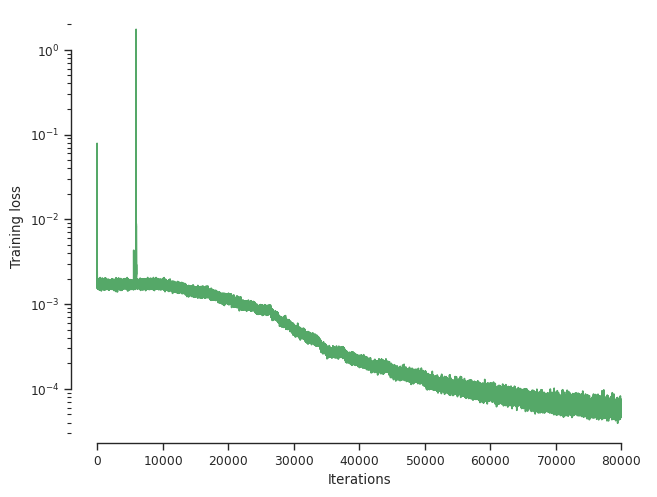

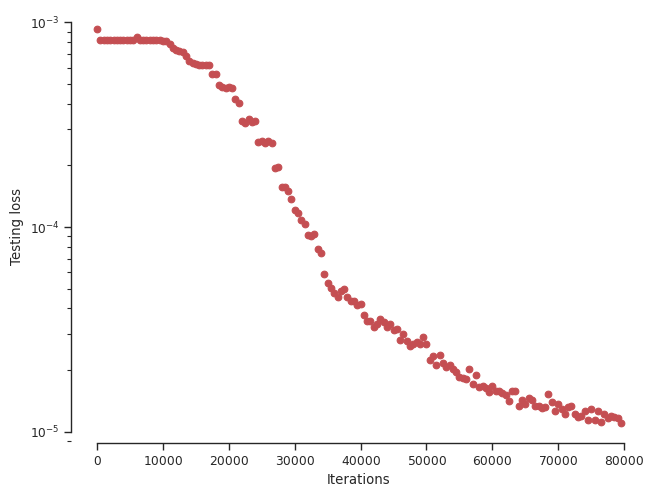

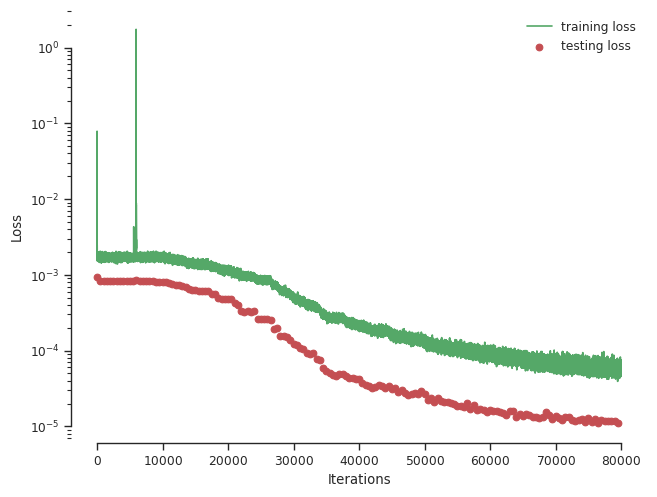

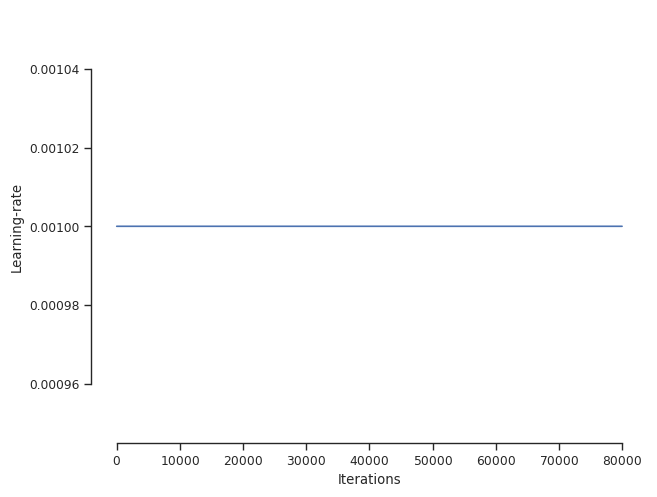

In [20]:
start_time = time.time()

bs = 32 # Batch size

neval_t = 21  # Number of time points at which latent output field is evaluated for a given input sample.
neval_x = neval_y = 64
# neval_loc = neval_x*neval_y  # Number of locations at which output field is evaluated at each time point.

neval_c = {'t': neval_t, 'loc': neval_x*neval_y}  # Number of collocation points within the domain.
neval_b = {'t': neval_t, 'loc': neval_x*1}        # Number of collocation points on each boundary.
neval_i = {'t': 1, 'loc': neval_x*neval_y}        # Number of collocation points at t=0.
        
# Training
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=20000, gamma=1.0) # gamma=0.8

iteration_list, loss_list, learningrates_list = [], [], []
datadriven_loss_list, pinn_loss_list = [], []
test_iteration_list, test_loss_list = [], []

for iteration in range(n_iterations):
    
    if n_used == 0:
        datadriven_loss = torch.tensor([0.]).to(device)
        # print('*********')
    else:
        indices_datadriven = torch.randperm(n_used).to(device) # Generate random permutation of indices
        inputs_train_used_batch = inputs_train_used.reshape(-1, 1, ny, nx)[indices_datadriven[0:bs]]
        outputs_train_used_batch = outputs_train_used.reshape(-1, nt, nx*ny)[indices_datadriven[0:bs]]
        # print(f"Shape of inputs_train_used_batch:", inputs_train_used_batch.shape) # (bs, no. of channels, height, width)
        # print(f"Shape of outputs_train_used_batch:", outputs_train_used_batch.shape) # (bs, nt, nx*ny)

        _, reconstruction_predicted_values = u_pred(model, inputs_train_used_batch, 
                                                          t_span.reshape(-1, 1), 
                                                          x_span.flatten().reshape(-1,1), 
                                                          y_span.flatten().reshape(-1,1)) # (bs, nt, latent_dim), (bs, nt, nx*ny)
        reconstruction_target_values = outputs_train_used_batch # (bs, nt, nx*ny)
        datadriven_loss = nn.MSELoss()(reconstruction_predicted_values, reconstruction_target_values)
        # print('*********')
    
    num_samples = len(inputs_initial_fields_only)
    indices_pinn = torch.randperm(num_samples).to(device) # Generate random permutation of indices
    inputs_batch = inputs_initial_fields_only.reshape(-1, 1, ny, nx)[indices_pinn[0:bs]]
    #print(f"Shape of inputs_batch:", inputs_batch.shape) # (bs, no. of channels, height, width)

    # points within the domain
    tc = td.uniform.Uniform(0., T).sample((neval_c['t'], 1)).to(device)
    xc = td.uniform.Uniform(0., L).sample((neval_c['loc'], 1)).to(device)
    yc = td.uniform.Uniform(0., L).sample((neval_c['loc'], 1)).to(device)
    
    # boundary points
    
    # for bc1a and bc1b
    t_bc1 = td.uniform.Uniform(0., T).sample((neval_b['t'], 1)).to(device)
    x_left = torch.full((neval_b['loc'], 1), 0.).to(device)
    x_right = torch.full((neval_b['loc'], 1), L).to(device)
    y_bc1 = td.uniform.Uniform(0, L).sample((neval_b['loc'], 1)).to(device)
    t_left, x_left, y_left = t_bc1, x_left, y_bc1
    t_right, x_right, y_right = t_bc1, x_right, y_bc1
    
    # for bc2a and bc2b
    t_bc2 = td.uniform.Uniform(0., T).sample((neval_b['t'], 1)).to(device)
    y_bottom = torch.full((neval_b['loc'], 1), 0.).to(device)
    y_top = torch.full((neval_b['loc'], 1), L).to(device)
    x_bc2 = td.uniform.Uniform(0, L).sample((neval_b['loc'], 1)).to(device)
    t_bottom, x_bottom, y_bottom = t_bc2, x_bc2, y_bottom
    t_top, x_top, y_top = t_bc2, x_bc2, y_top
    
    tb = [t_left, t_right, t_bottom, t_top]
    xb = [x_left, x_right, x_bottom, x_top]
    yb = [y_left, y_right, y_bottom, y_top]
    
    # initial points
    ti = torch.zeros((1, 1)).to(device)
    xi = td.uniform.Uniform(0., L).sample((neval_i['loc'], 1)).to(device)
    yi = td.uniform.Uniform(0., L).sample((neval_i['loc'], 1)).to(device)
    

    pinn_loss = (loss_pde_residual(model, inputs_batch, tc, xc, yc) 
                 + loss_pde_bcs(model, inputs_batch, tb, xb, yb) 
                 + loss_pde_ic(model, inputs_batch, ti, xi, yi))
    # print('*********')

    optimizer.zero_grad()
    loss = datadriven_loss + pinn_loss
    loss.backward()
    # torch.nn.utils.clip_grad_value_(model.parameters(), clip_value=1.0)
    optimizer.step()
    scheduler.step()
    
    if iteration % 500 == 0:
        # Test loss calculation
        model.eval()  # Set model to evaluation mode
        with torch.no_grad():
            test_predicted_values = u_pred(model, inputs_test.reshape(-1, 1, ny, nx), 
                              t_span.reshape(-1, 1), 
                              x_span.flatten().reshape(-1,1), 
                              y_span.flatten().reshape(-1,1))[1]  # (bs, neval) = (bs, nt, nx*ny)
            test_loss = nn.MSELoss()(test_predicted_values, outputs_test.reshape(-1, nt, nx*ny))
            test_iteration_list.append(iteration)
            test_loss_list.append(test_loss.item())  
        model.train()  # Switch back to training mode
        print('Iteration %s -' % iteration, 'loss = %f,' % loss,
              'data-driven loss = %f,' % datadriven_loss,'pinn loss = %f,' % pinn_loss,
              'learning rate = %f,' % optimizer.state_dict()['param_groups'][0]['lr'], 
              'test loss = %f' % test_loss)

    iteration_list.append(iteration)
    loss_list.append(loss.item())
    datadriven_loss_list.append(datadriven_loss.item())
    pinn_loss_list.append(pinn_loss.item())
    learningrates_list.append(optimizer.state_dict()['param_groups'][0]['lr'])
    
if save == True:
    np.save(os.path.join(resultdir,'iteration_list.npy'), np.asarray(iteration_list))
    np.save(os.path.join(resultdir,'loss_list.npy'), np.asarray(loss_list))
    np.save(os.path.join(resultdir, 'datadriven_loss_list.npy'), np.asarray(datadriven_loss_list))
    np.save(os.path.join(resultdir, 'pinn_loss_list.npy'), np.asarray(pinn_loss_list))
    np.save(os.path.join(resultdir,'learningrates_list.npy'), np.asarray(learningrates_list))
    np.save(os.path.join(resultdir,'test_iteration_list.npy'), np.asarray(test_iteration_list))
    np.save(os.path.join(resultdir, 'test_loss_list.npy'), np.asarray(test_loss_list)) 


plot_loss_terms(resultdir, iteration_list, loss_list, datadriven_loss_list, pinn_loss_list, save)  
    
plot_training_loss(resultdir, iteration_list, loss_list, save)

plot_testing_loss(resultdir, test_iteration_list, test_loss_list, save)

plot_training_testing_loss(resultdir, iteration_list, loss_list, test_iteration_list, test_loss_list, save)

plot_learningrates(resultdir, iteration_list, learningrates_list, save)  
    
# end timer
end_time = time.time()
training_time = end_time - start_time

runtime_per_iter = training_time/n_iterations # in sec/iter

In [21]:
if save == True:
    torch.save(model.state_dict(), os.path.join(resultdir,'model_state_dict.pt'))
# model.load_state_dict(torch.load(os.path.join(resultdir, 'model_state_dict.pt'), map_location=device))

TEST SAMPLE 5
Rel. L2 Error = 0.1192, R2 score = 0.9858


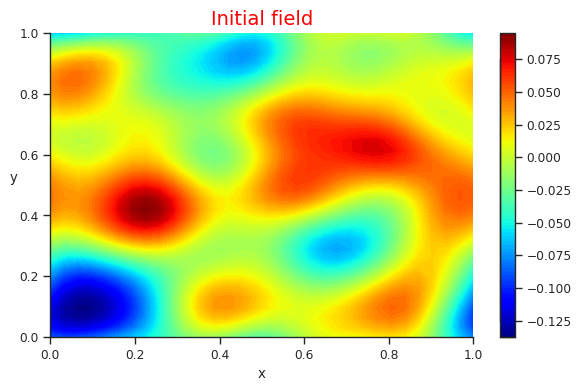

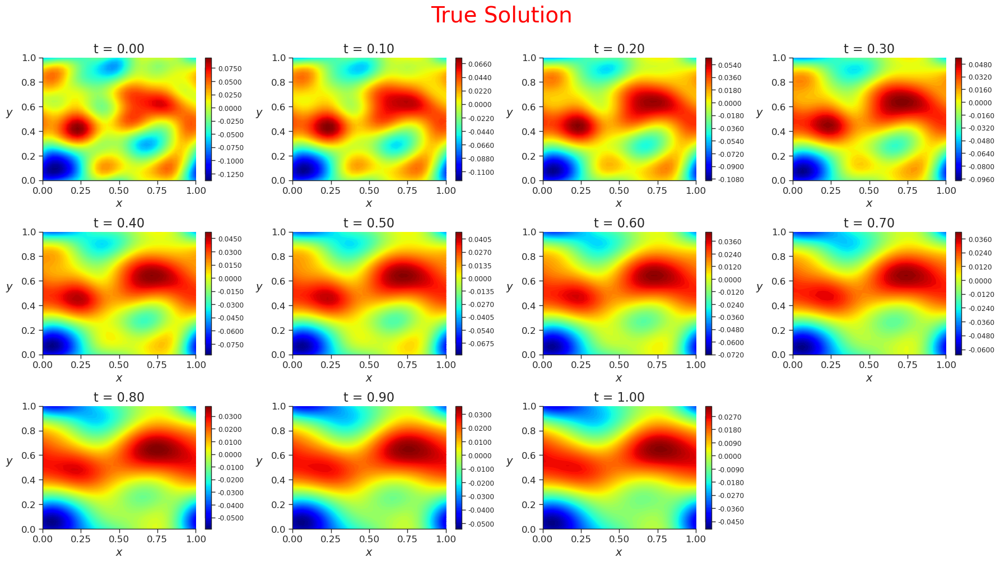

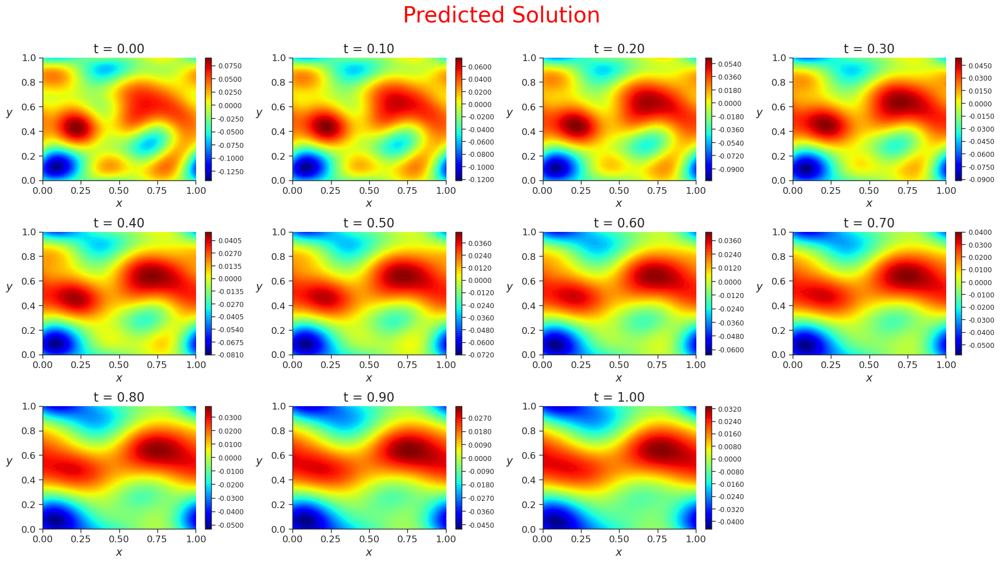

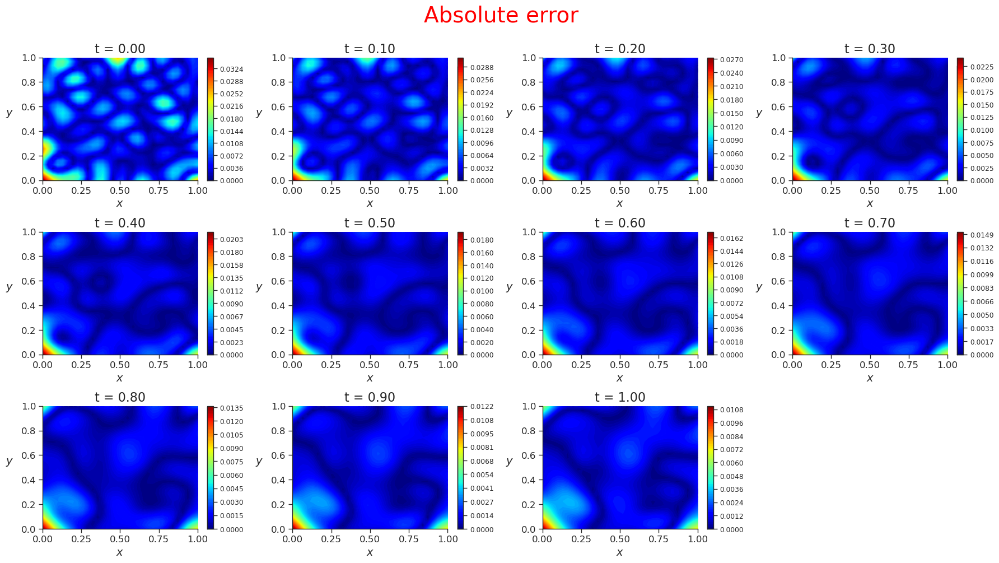

######################################################################################################################################################################################################################################
TEST SAMPLE 10
Rel. L2 Error = 0.1241, R2 score = 0.9846


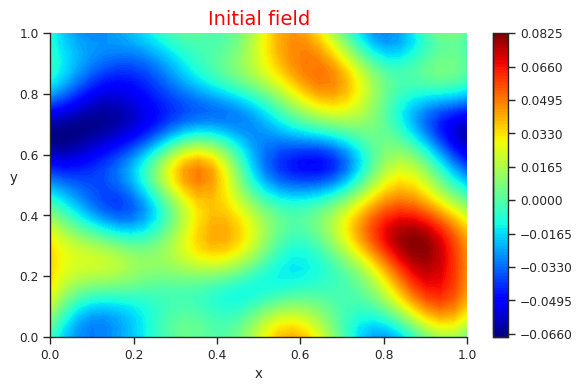

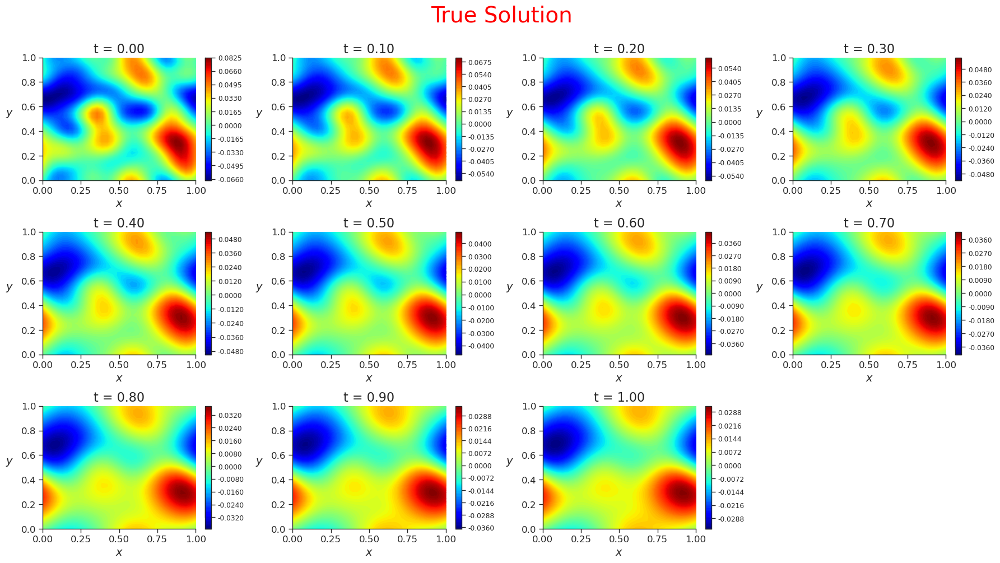

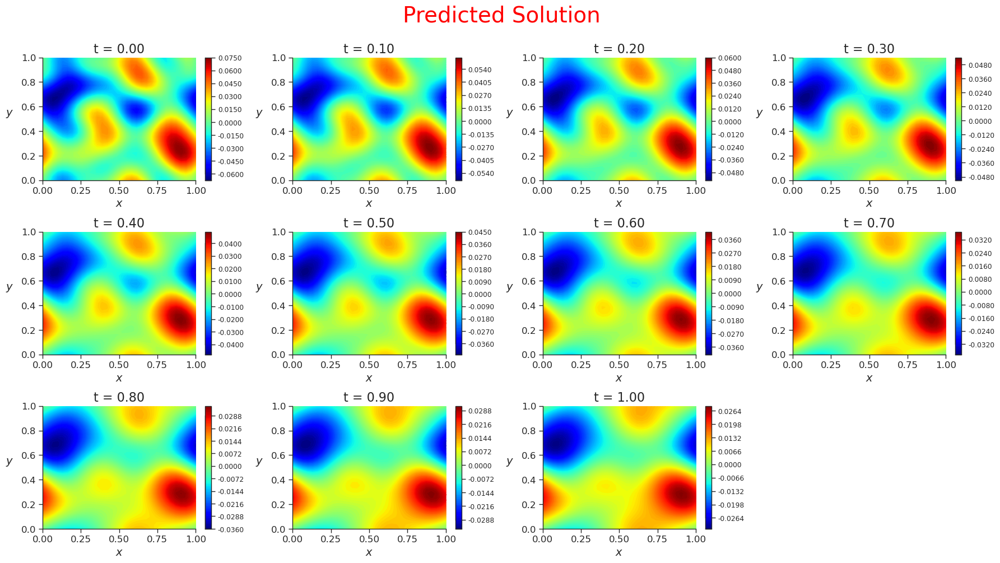

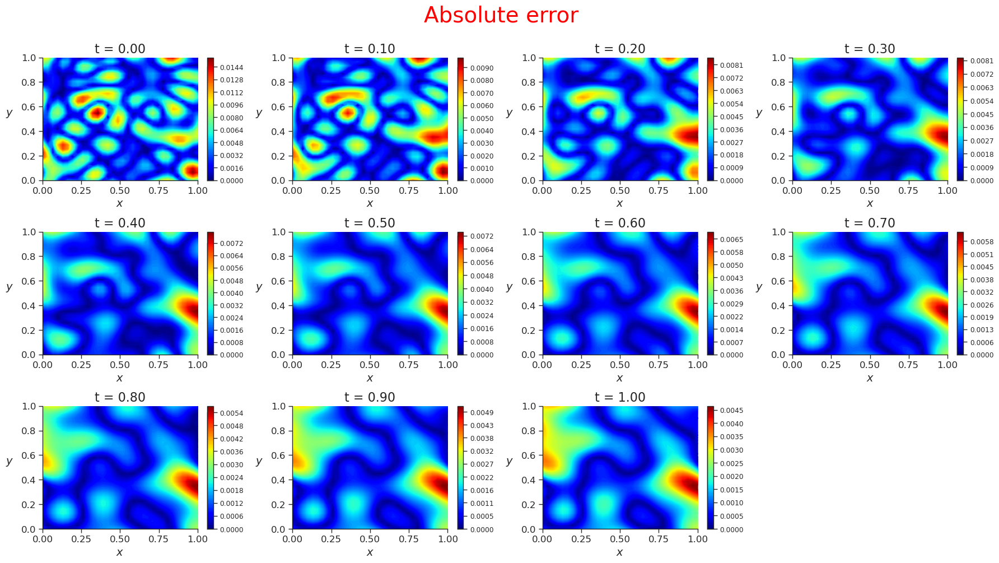

######################################################################################################################################################################################################################################
TEST SAMPLE 15
Rel. L2 Error = 0.0968, R2 score = 0.9906


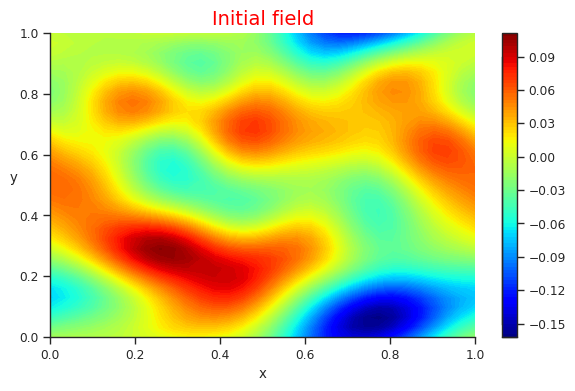

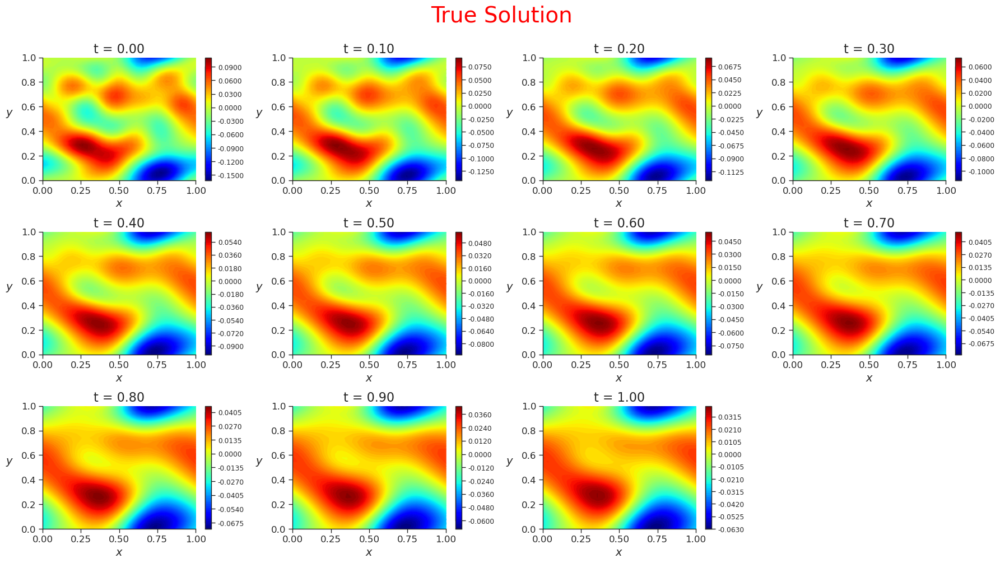

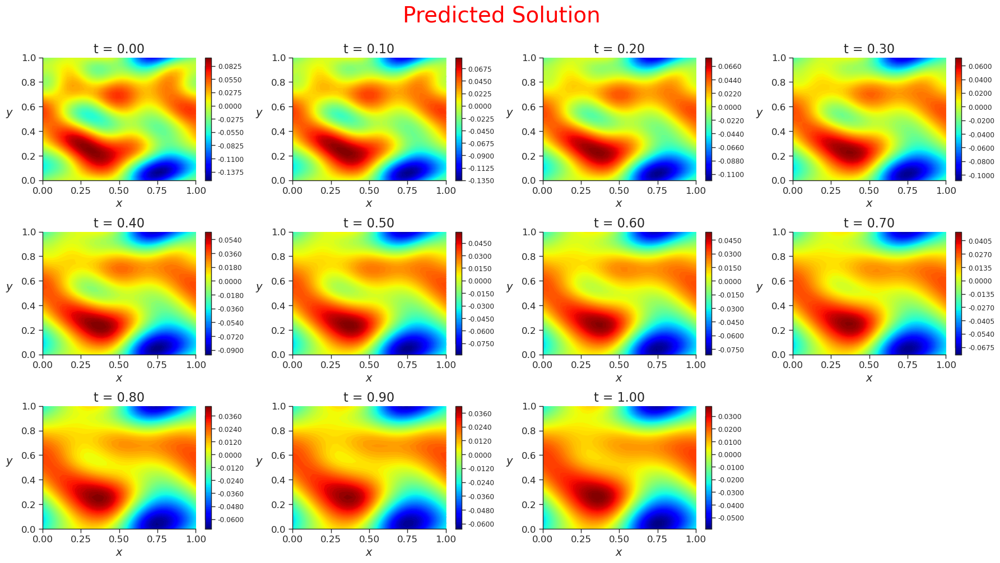

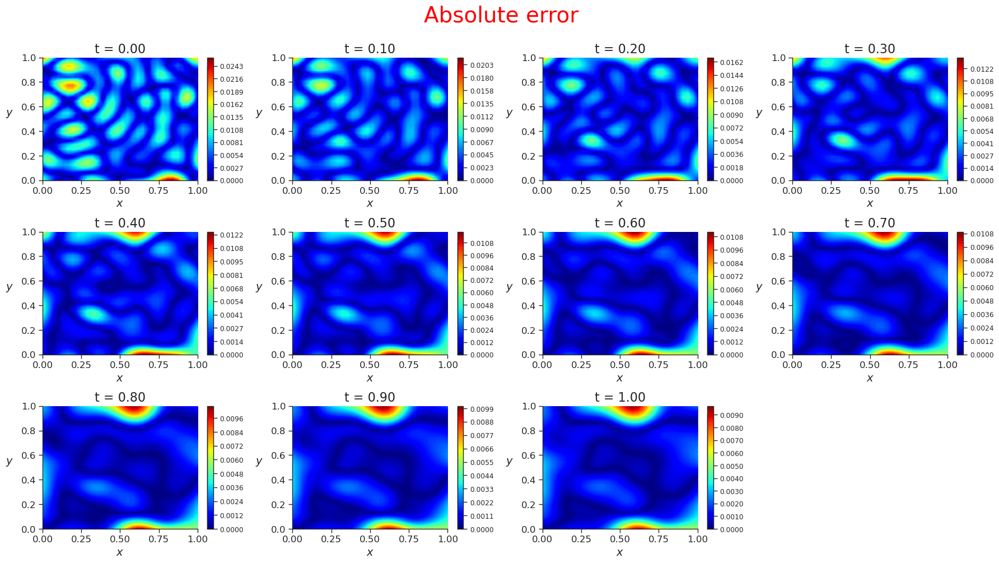

######################################################################################################################################################################################################################################
TEST SAMPLE 20
Rel. L2 Error = 0.1064, R2 score = 0.9887


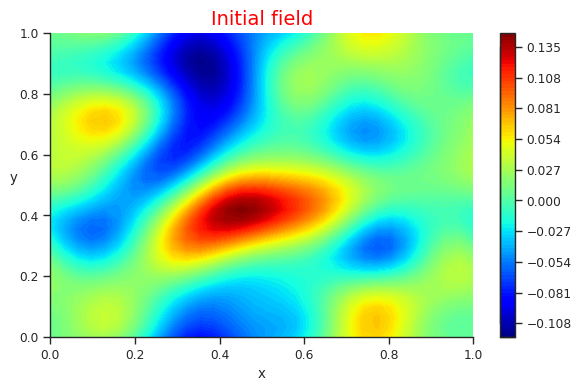

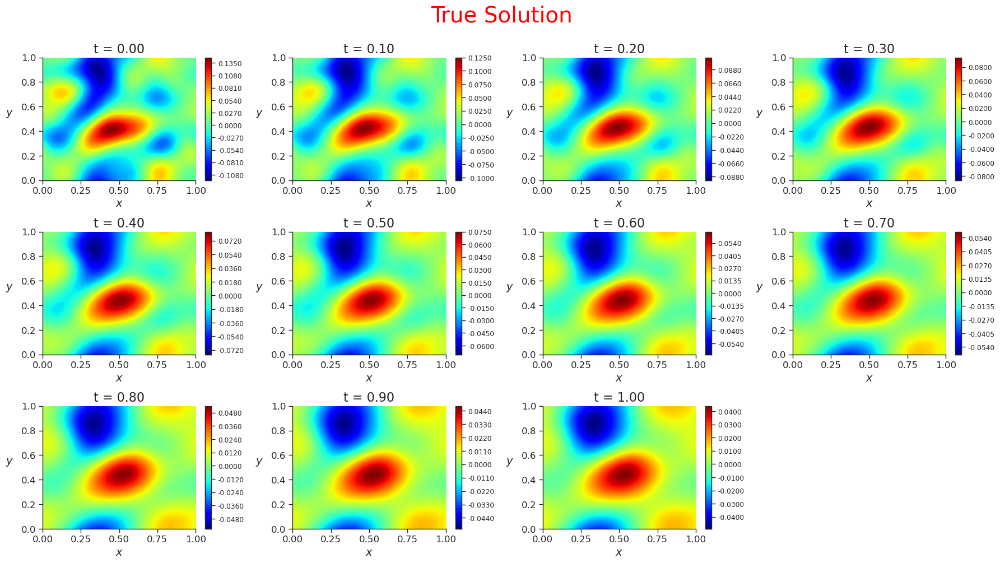

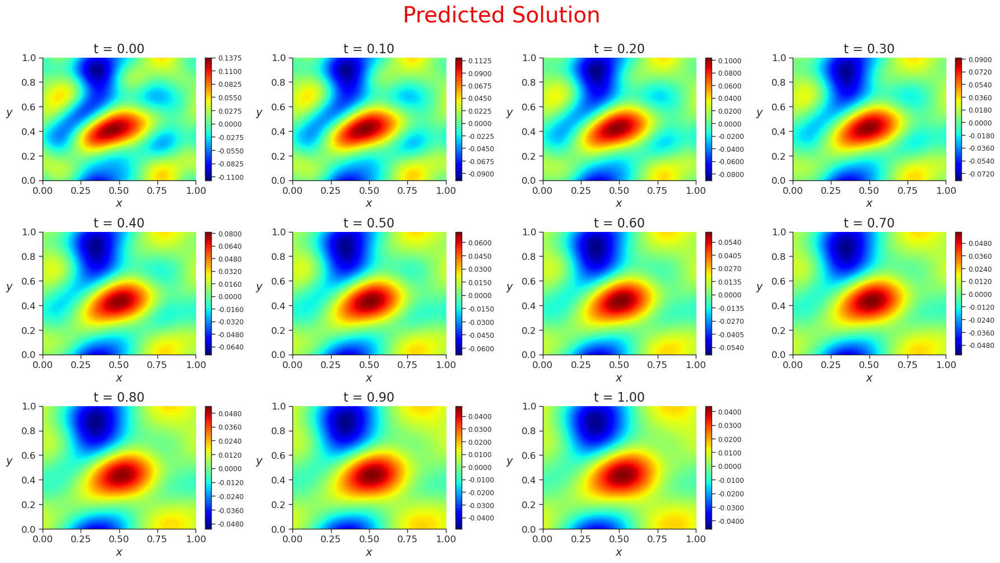

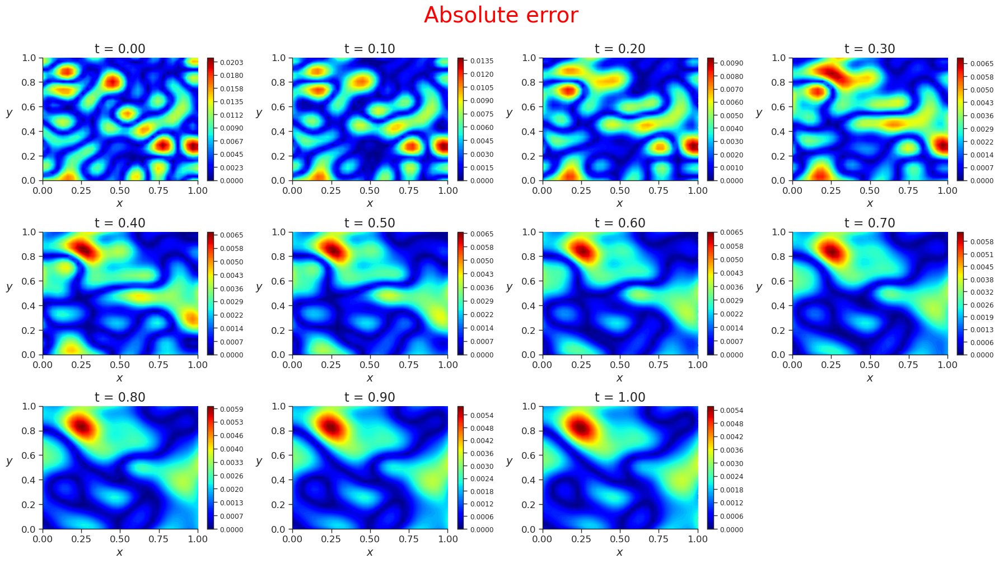

######################################################################################################################################################################################################################################
TEST SAMPLE 25
Rel. L2 Error = 0.1113, R2 score = 0.9876


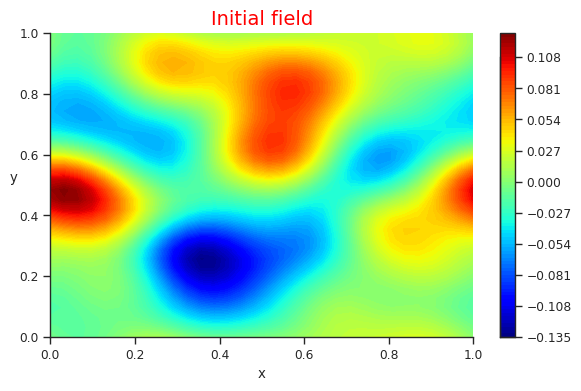

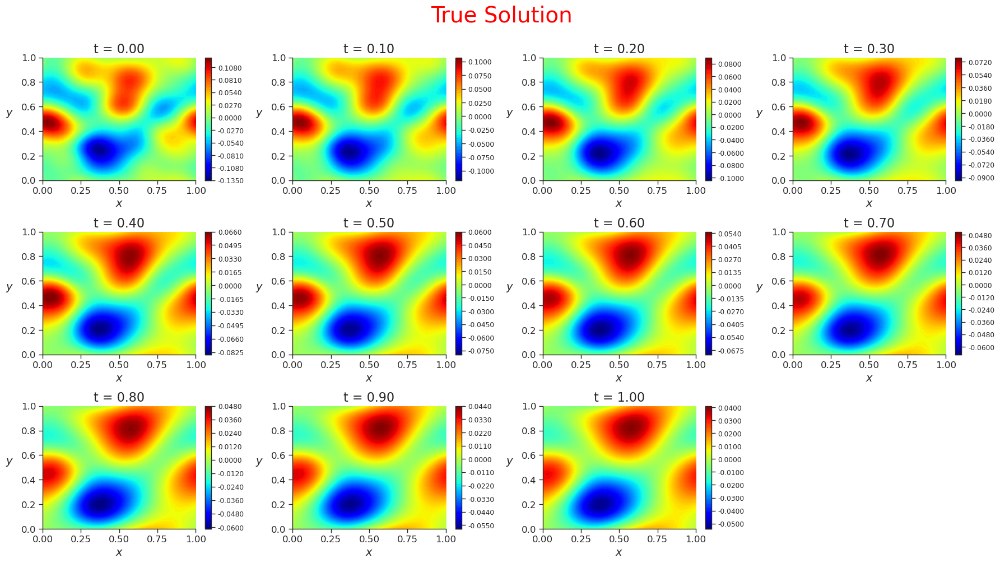

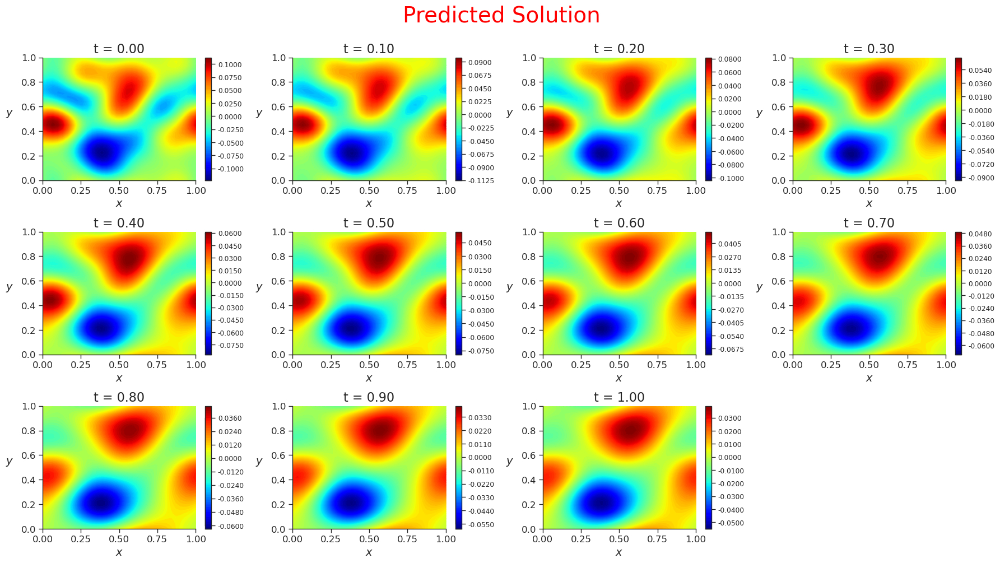

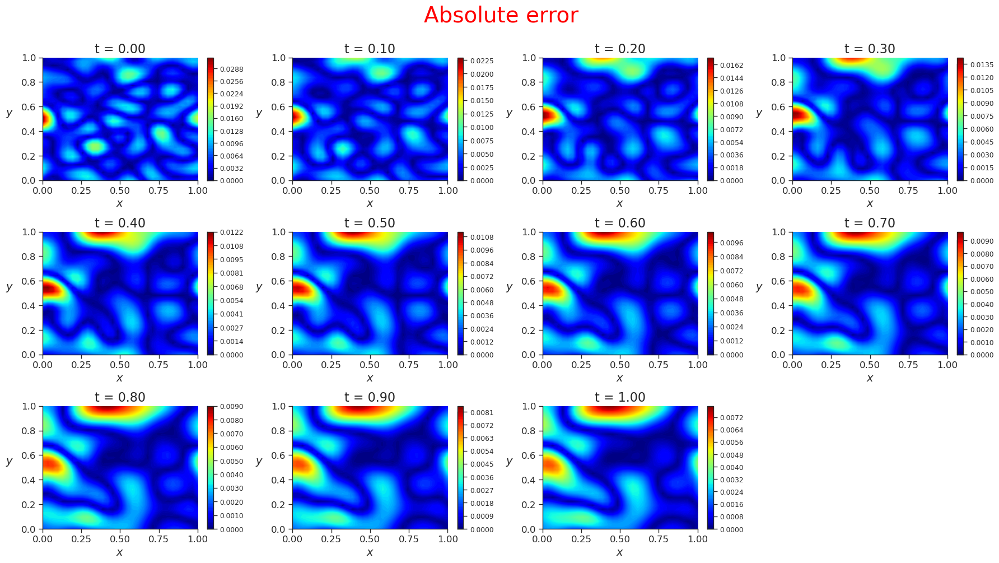

######################################################################################################################################################################################################################################
TEST SAMPLE 30
Rel. L2 Error = 0.1232, R2 score = 0.9848


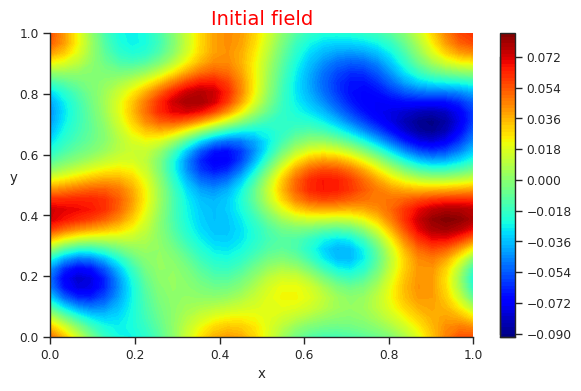

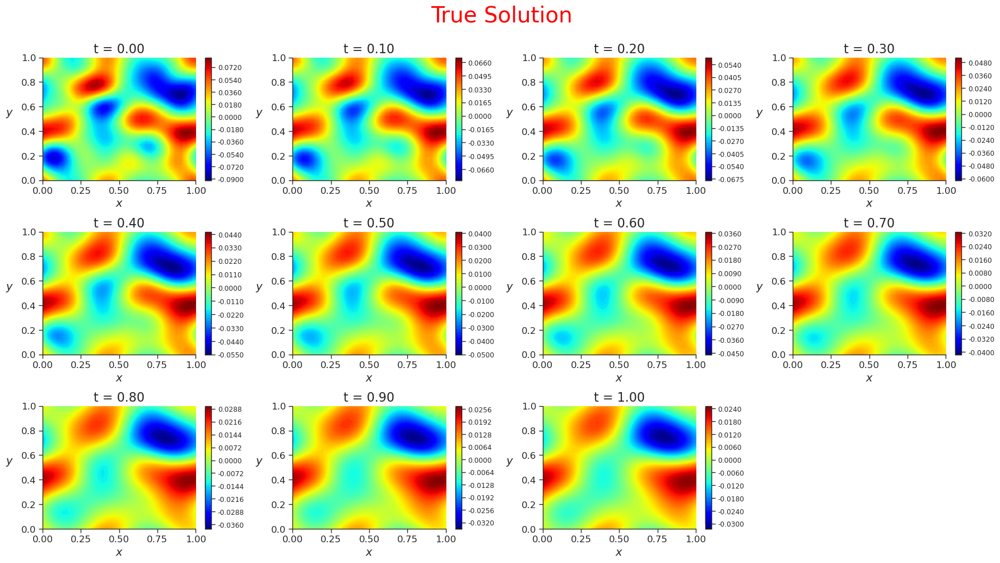

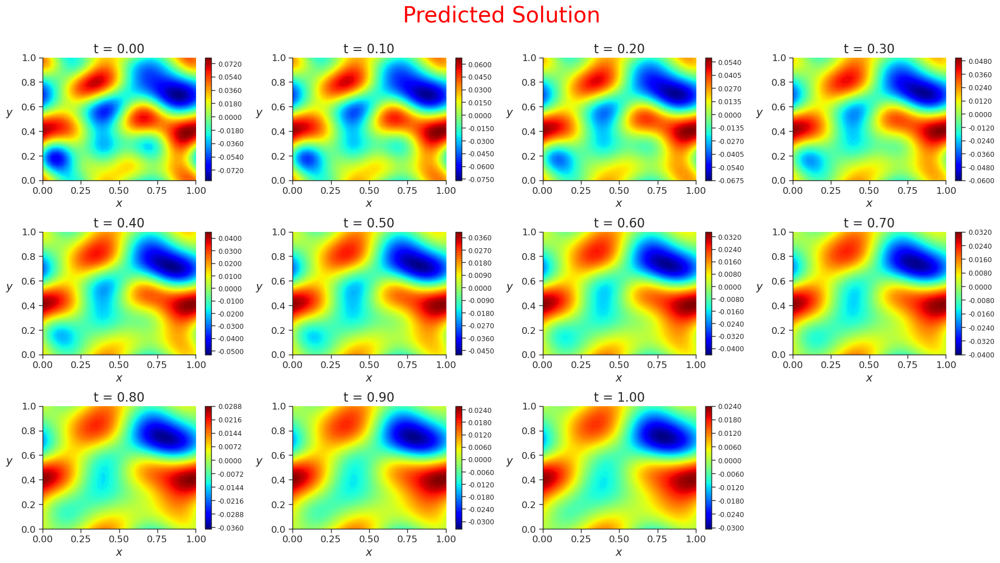

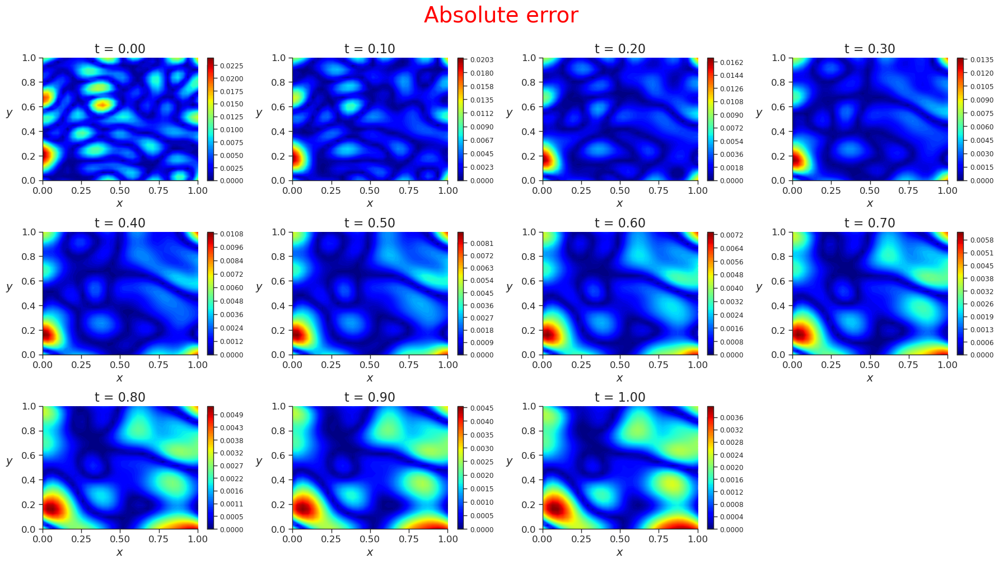

######################################################################################################################################################################################################################################
TEST SAMPLE 35
Rel. L2 Error = 0.1061, R2 score = 0.9887


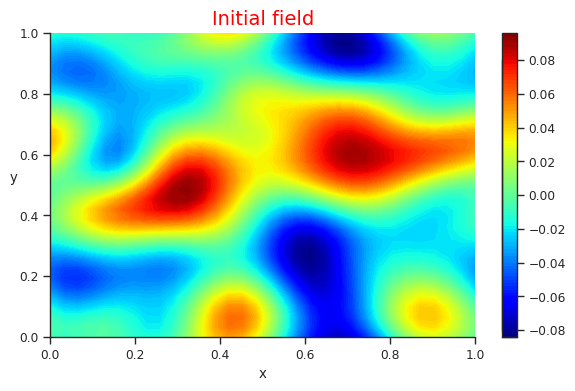

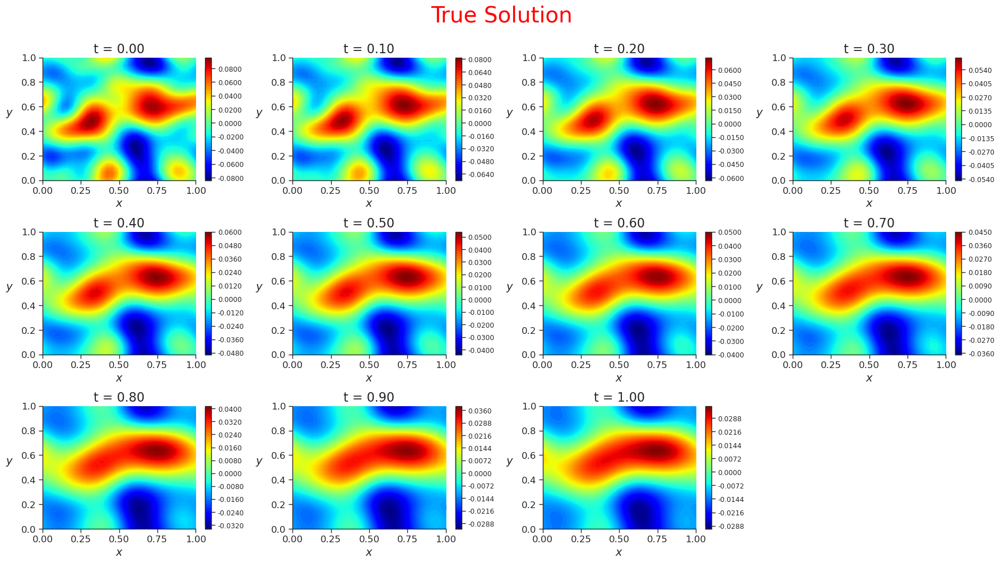

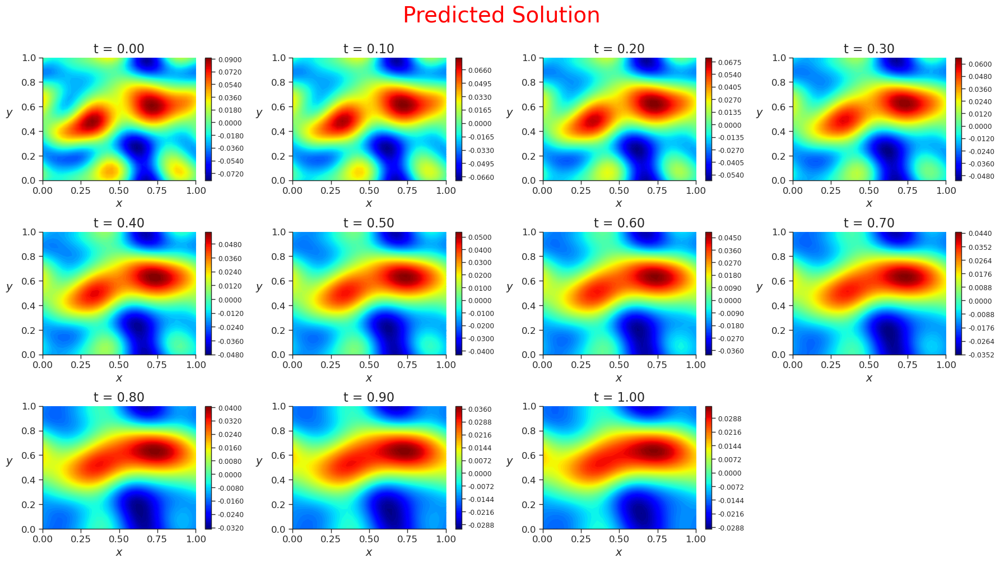

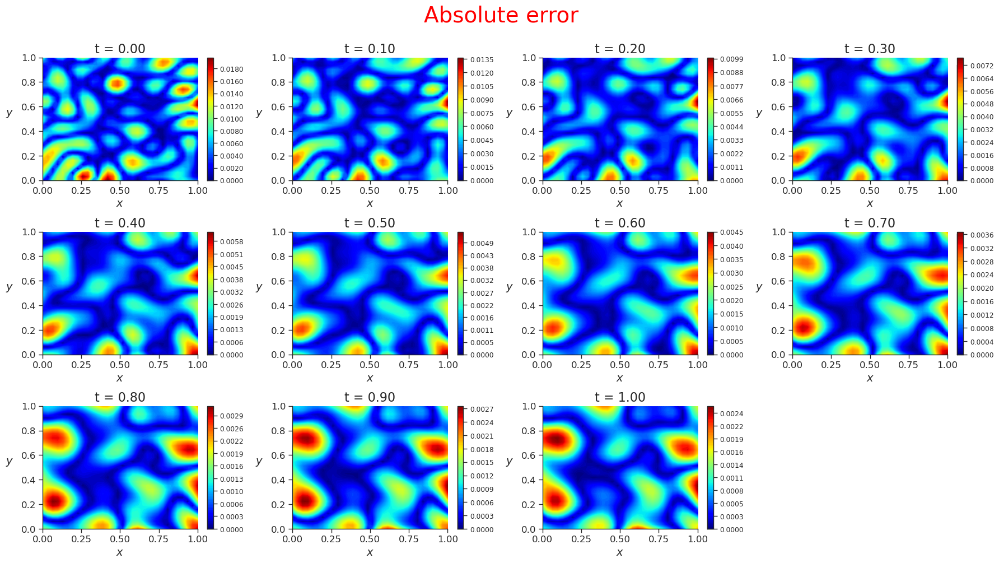

######################################################################################################################################################################################################################################
TEST SAMPLE 40
Rel. L2 Error = 0.1405, R2 score = 0.9803


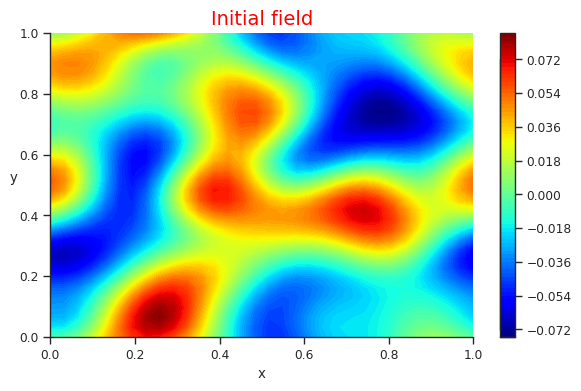

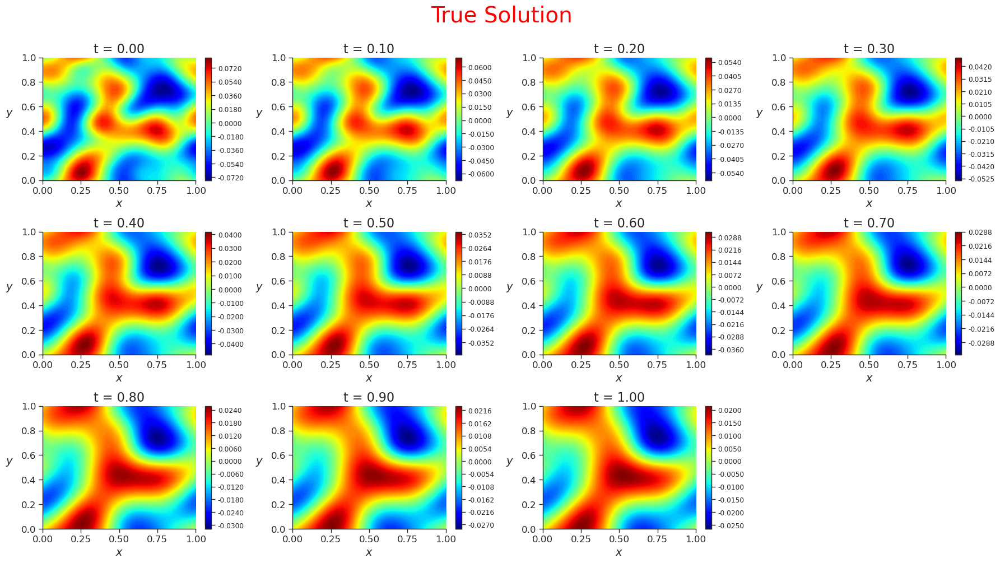

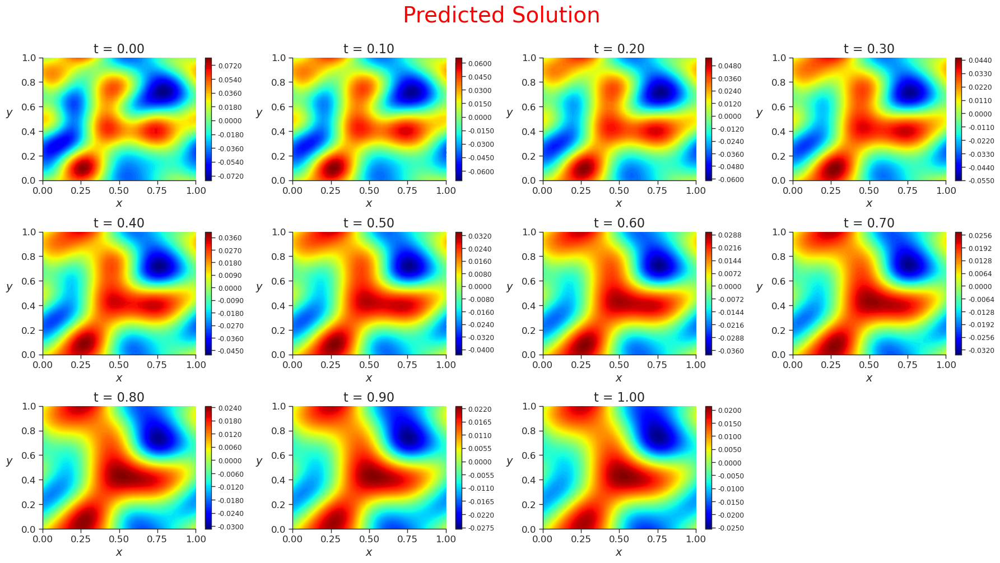

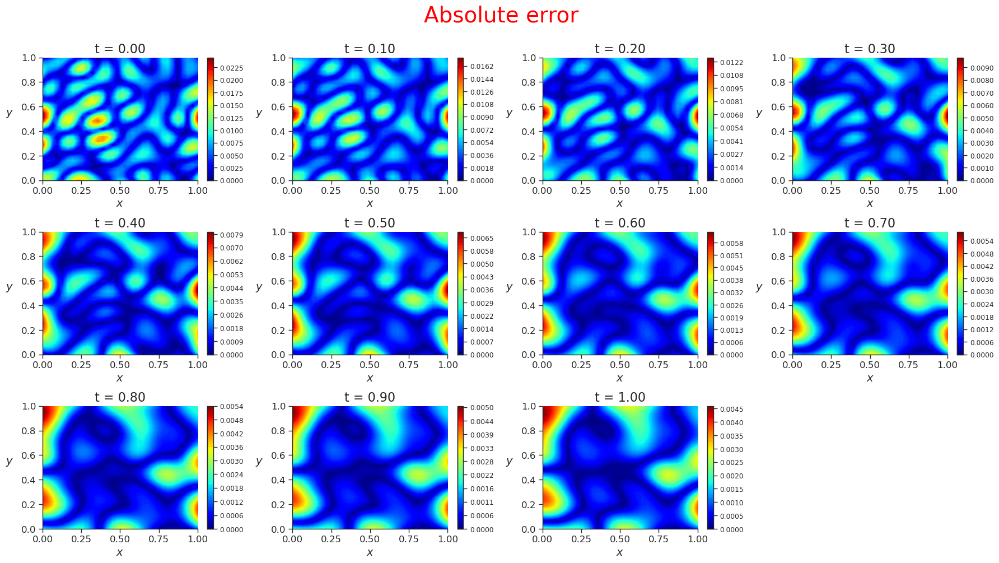

######################################################################################################################################################################################################################################
TEST SAMPLE 45
Rel. L2 Error = 0.1145, R2 score = 0.9869


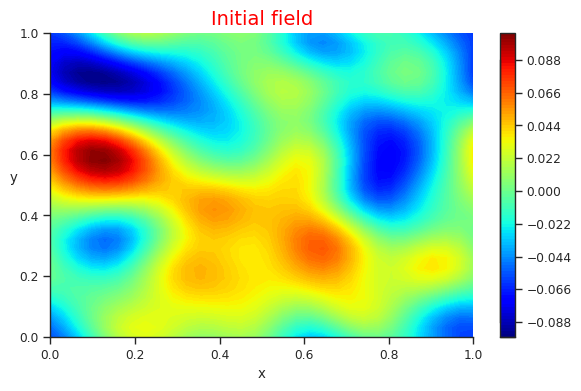

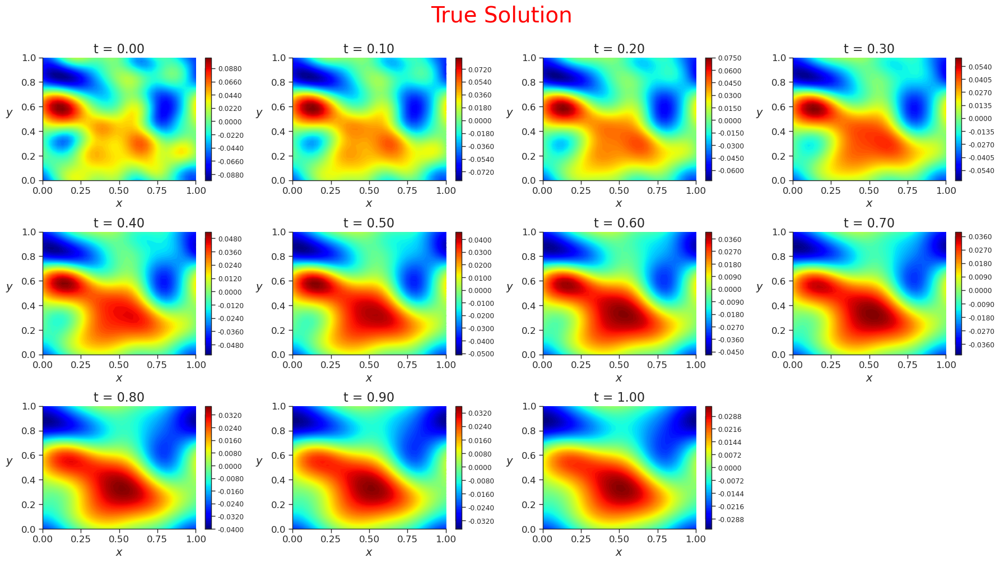

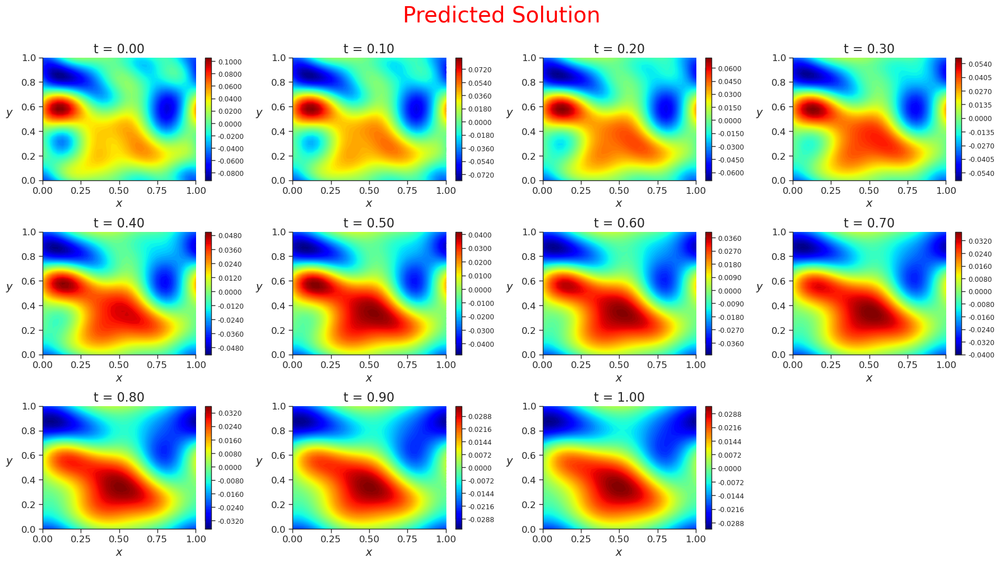

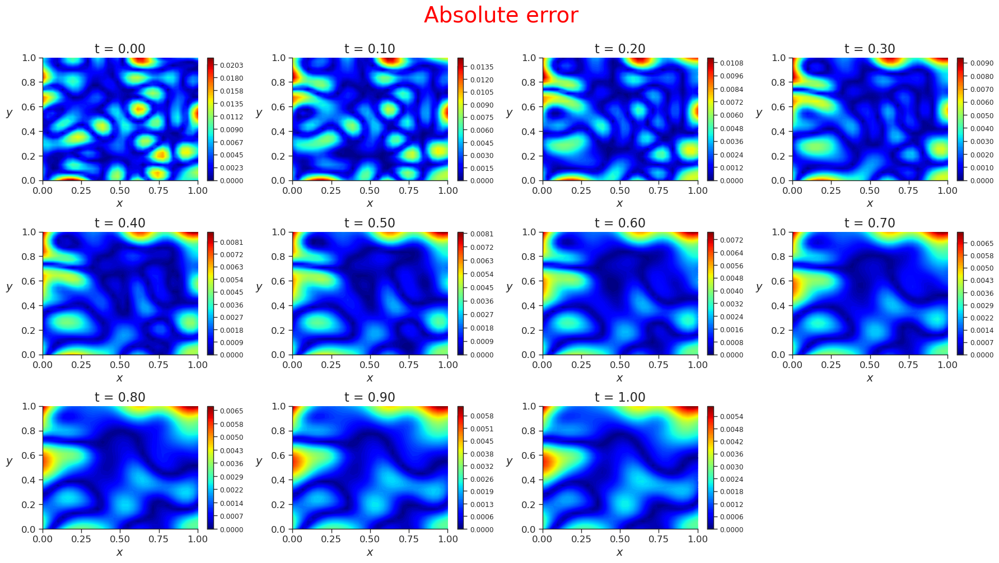

######################################################################################################################################################################################################################################
TEST SAMPLE 50
Rel. L2 Error = 0.124, R2 score = 0.9846


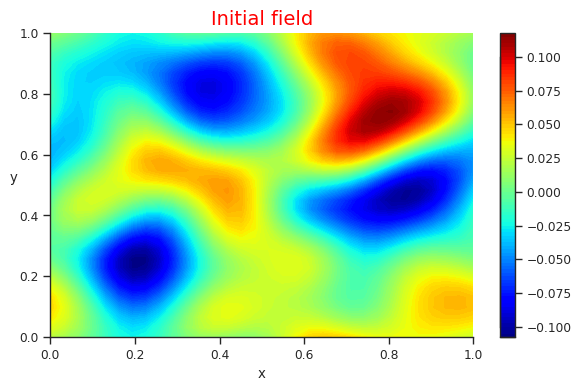

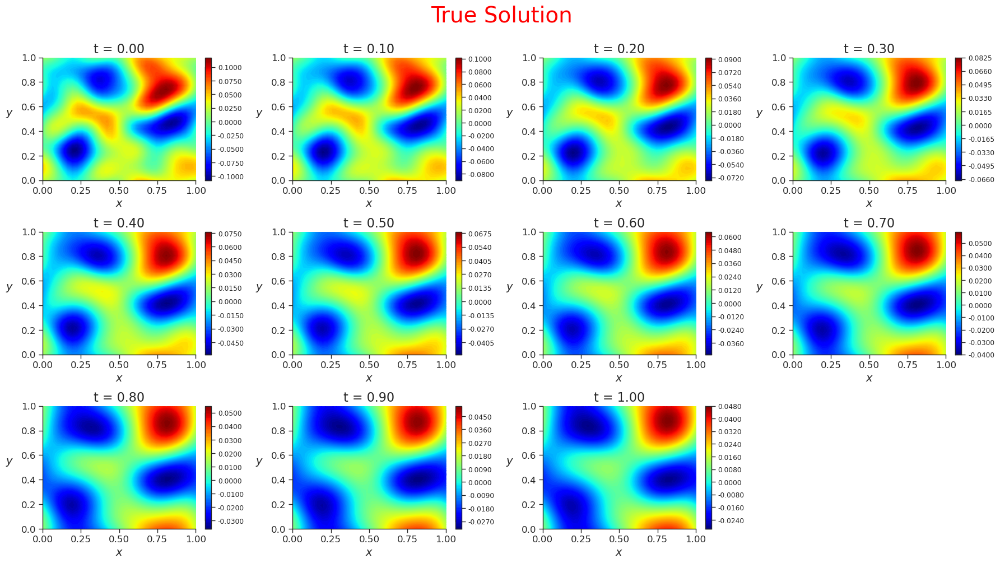

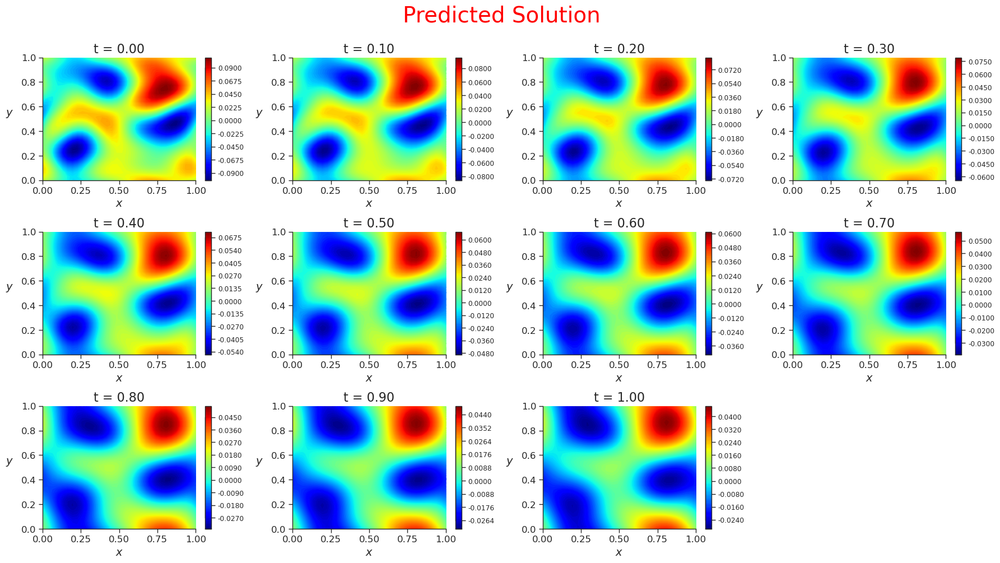

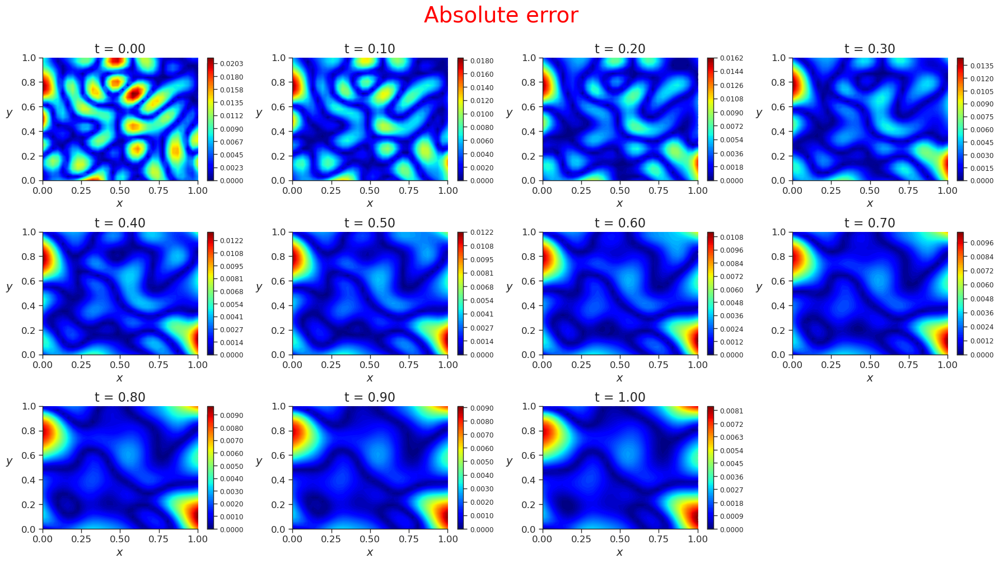

######################################################################################################################################################################################################################################
Mean Squared Error Test:
 1.1214440964977257e-05
R2 score Test:
 0.9855027742201744
Rel. L2 Error Test:
 0.11949741691350937


In [22]:
# Predictions
_, reconstruction_predictions_test = u_pred(model, inputs_test.reshape(-1, 1, ny, nx), 
                                                                  t_span.reshape(-1, 1), 
                                                                  x_span.flatten().reshape(-1,1), 
                                                                  y_span.flatten().reshape(-1,1)) # (bs, nt, latent_dim), (bs, nt, nx*ny)
# print(reconstruction_predictions_test.shape)

mse_list, r2score_list, relerror_list = [], [], []

for i in range(inputs_test.shape[0]):
    
    reconstruction_prediction_i = reconstruction_predictions_test[i].unsqueeze(0)# (1, nt, nx*ny)
    reconstruction_target_i = outputs_test[i].reshape(nt, nx*ny).unsqueeze(0) # (1, nt, nx*ny)

    reconstruction_mse_i = F.mse_loss(reconstruction_prediction_i.cpu(), reconstruction_target_i.cpu())
    mse_i = reconstruction_mse_i
    
    r2score_i = metrics.r2_score(reconstruction_target_i.flatten().cpu().detach().numpy(), reconstruction_prediction_i.flatten().cpu().detach().numpy()) 
    relerror_i = np.linalg.norm(reconstruction_target_i.flatten().cpu().detach().numpy() - reconstruction_prediction_i.flatten().cpu().detach().numpy()) / np.linalg.norm(reconstruction_target_i.flatten().cpu().detach().numpy())
        
    mse_list.append(mse_i.item())
    r2score_list.append(r2score_i.item())
    relerror_list.append(relerror_i.item())
    
    # Plot the full solution-field for few cases:
    if (i+1) % 5 == 0:
        print(colored('TEST SAMPLE '+str(i+1), 'red'))

        r2score_i = float('%.4f'%r2score_i)
        relerror_i = float('%.4f'%relerror_i)
        print('Rel. L2 Error = '+str(relerror_i)+', R2 score = '+str(r2score_i))
        
        cmap = 'jet'  # Color map
        fontsize = 14  # Font size for labels and titles
        levels = 100
        # Plotting 
        plot_input_field(i, x_span.cpu().detach().numpy(), y_span.cpu().detach().numpy(), inputs_test[i].cpu().detach().numpy(), f"Initial field", cmap, fontsize, levels, resultdir, save)
        plot_solution_field(i, x_span.cpu().detach().numpy(), y_span.cpu().detach().numpy(), reconstruction_target_i.reshape(nt,ny,nx).cpu().detach().numpy(), t_span.cpu().detach().numpy(), f"True Solution", cmap, fontsize, levels, resultdir, save, 'True-Solution')
        plot_solution_field(i, x_span.cpu().detach().numpy(), y_span.cpu().detach().numpy(), reconstruction_prediction_i.reshape(nt,ny,nx).cpu().detach().numpy(), t_span.cpu().detach().numpy(), f"Predicted Solution", cmap, fontsize, levels, resultdir, save, 'Predicted-Solution')
        plot_solution_field(i, x_span.cpu().detach().numpy(), y_span.cpu().detach().numpy(), torch.abs(reconstruction_target_i.reshape(nt,ny,nx) - reconstruction_prediction_i.reshape(nt,ny,nx)).cpu().detach().numpy(), t_span.cpu().detach().numpy(), f"Absolute error", cmap, fontsize, levels, resultdir, save, 'Absolute error')
        print(colored('#'*230, 'green'))
        
mse = sum(mse_list) / len(mse_list)
print("Mean Squared Error Test:\n", mse)
r2score = sum(r2score_list) / len(r2score_list)
print("R2 score Test:\n", r2score)
relerror = sum(relerror_list) / len(relerror_list)
print("Rel. L2 Error Test:\n", relerror)

In [23]:
test_dict = {
    "inputs_test": inputs_test.cpu(),
    "outputs_test": outputs_test.cpu(),
    "predictions_test": reconstruction_predictions_test.reshape(-1, nt, ny, nx).cpu()
}
for key, value in test_dict.items():
    print(f"Shape of {key}: {value.shape}")
print(colored('#'*230, 'green'))

if save == True:
    torch.save(test_dict, os.path.join(resultdir,'test_dict.pth'))

Shape of inputs_test: torch.Size([50, 32, 32])
Shape of outputs_test: torch.Size([50, 21, 32, 32])
Shape of predictions_test: torch.Size([50, 21, 32, 32])
######################################################################################################################################################################################################################################


In [24]:
performance_metrics(mse, r2score, relerror, training_time, runtime_per_iter, resultdir, save)

Mean Squared Error Test:
1.1214440964977257e-05
R2 score Test:
0.9855027742201744
Rel. L2 Error Test:
0.11949741691350937
Training Time (in sec):
52535.35145187378
Runtime per Iteration (in sec/iter):
0.657
